# Facial image clustering

In [255]:
import torch
import pandas as pd
import matplotlib.pyplot as plt

from pprint import pprint
from glob import glob
from tqdm import tqdm
from PIL import Image
from colorhash import ColorHash

from facenet_pytorch import InceptionResnetV1, MTCNN

from torchvision import transforms, datasets
from torch.utils.data import DataLoader, Dataset

from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
from sklearn.cluster import DBSCAN

Load pretrained facial recognision model (InceptionResnetV1) trained on the vggface2 dataset

In [233]:
device = 'cuda' if torch.cuda.is_available() else 'cpu'
print(f'Running on device: {device}')

mtcnn = MTCNN(device=device)

resnet = InceptionResnetV1(pretrained='vggface2', device=device).eval()

Running on device: cpu


In [246]:
embeddings = []
image_paths = []
for img_path in tqdm(glob("../../datasets/fr/**/*.jpg", recursive=True)):
    with torch.no_grad():
        try:
            img_pil = Image.open(img_path).convert("RGB")
            img_cropped = mtcnn(img_pil)
            img_embedding = resnet(img_cropped.unsqueeze(0))
            embeddings.append(img_embedding.squeeze().cpu().tolist())
            image_paths.append(img_path)
        except:
            print(f"\t[ERROR] {img_path}")

100%|██████████| 2680/2680 [17:36<00:00,  2.54it/s]


In [247]:
pca_embeddings = PCA(n_components=50).fit_transform(embeddings)
df = pd.DataFrame({'path': image_paths, 'embedding': pca_embeddings.tolist()})
df.to_csv('../../annotations/fr-embedings.csv')

In [248]:
def scatter_thumbnails(data, images, zoom=0.12, colors=None):
    assert len(data) == len(images)

    # reduce embedding dimentions to 2
    x = PCA(n_components=2).fit_transform(data) if len(data[0]) > 2 else data

    # create a scatter plot.
    f = plt.figure(figsize=(30, 30))
    ax = plt.subplot(aspect='equal')
    sc = ax.scatter(x[:,0], x[:,1], s=4)
    _ = ax.axis('off')
    _ = ax.axis('tight')

    # add thumbnails :)
    from matplotlib.offsetbox import OffsetImage, AnnotationBbox
    for i in range(len(images)):
        image = plt.imread(images[i])
        im = OffsetImage(image, zoom=zoom)
        bboxprops = dict(edgecolor=colors[i]) if colors is not None else None
        ab = AnnotationBbox(im, x[i], xycoords='data',
                            frameon=(bboxprops is not None),
                            pad=0.02,
                            bboxprops=bboxprops)
        ax.add_artist(ab)
    return ax

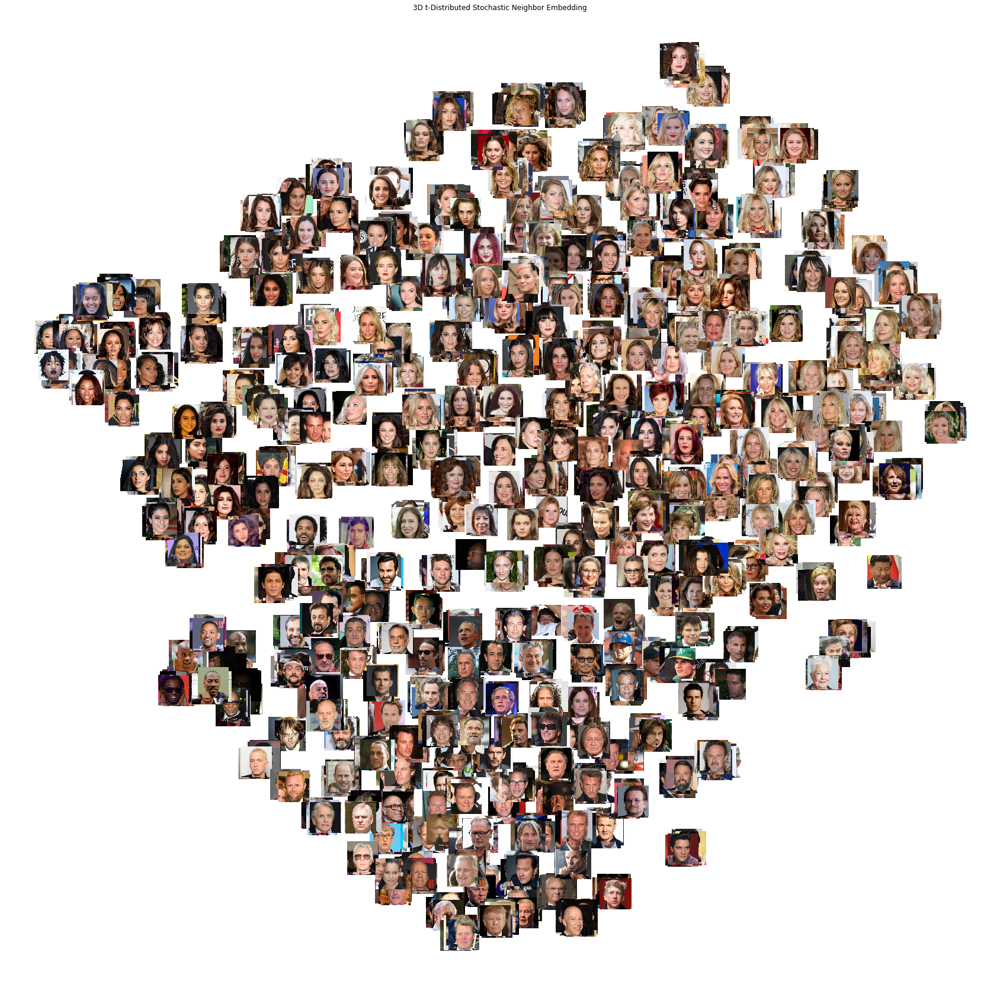

In [249]:
x = TSNE(perplexity=50, n_components=2).fit_transform(pca_embeddings)

_ = scatter_thumbnails(x, image_paths, zoom=0.1)
plt.title('3D t-Distributed Stochastic Neighbor Embedding')
plt.show()

In [273]:

pprint(lala)

['Family_64/sistine_rose_stallone_daughter',
 'Family_64/sistine_rose_stallone_daughter',
 'Family_64/sistine_rose_stallone_daughter',
 'Family_64/sistine_rose_stallone_daughter',
 'Family_64/sistine_rose_stallone_daughter',
 'Family_64/sistine_rose_stallone_daughter',
 'Family_64/sistine_rose_stallone_daughter',
 'Family_64/sylvester_stallone_father',
 'Family_64/sylvester_stallone_father',
 'Family_64/sylvester_stallone_father',
 'Family_64/sylvester_stallone_father',
 'Family_64/sylvester_stallone_father',
 'Family_64/sylvester_stallone_father',
 'Family_64/sylvester_stallone_father',
 'Family_64/sylvester_stallone_father',
 'Family_64/jennifer_flavin_mother',
 'Family_64/jennifer_flavin_mother',
 'Family_64/jennifer_flavin_mother',
 'Family_64/jennifer_flavin_mother',
 'Family_64/jennifer_flavin_mother',
 'Family_64/jennifer_flavin_mother',
 'Family_64/jennifer_flavin_mother',
 'Family_29/Brian_Williams_father',
 'Family_29/Brian_Williams_father',
 'Family_29/Brian_Williams_father'

In [275]:
from matplotlib.markers import MarkerStyle

plt.figure(figsize=(30, 30))

markers = list(set(MarkerStyle.markers.keys()))
names = list(map(lambda x: '/'.join(x.split("/")[-3:-1]), image_paths))
colors = list(map(lambda x: ColorHash(x).hex, names))

step=len(set(names))/len(colors)

marker_i = 0
start=0
count=1
for end in range(1, len(names)):
    if names[end] != names[end-1]: count+=1
    if count > step:
        plt.scatter(x[start:end,0], x[start:end,1], marker=markers[marker_i], c=colors[start:end])
        marker_i+=1
        start=end
        count=1

# index_chunks = [lst[i:i + n] for i in range(0, len(lst), n)]


# plt.scatter(x[:,0], x[:,1], marker='.', c=colors)
plt.show()

ValueError: Unrecognized marker style 'tri_right'